<br>


# Chicagos best neighborhoods for chinese restaurants 
by *Alexander Kowsik*

<br>

**Analyzing Chicagos community areas by crime rates, rent prices, houshold incomes and restaurant locations to determine the safest and most lucrative neighborhoods to open a new chinese restaurant.**   

To see the full structured report with all details and conclusions of the analysis, check out my [GitHub](https://github.com/alexkowsik/Coursera_Capstone).

<br>


***

## Table of Contents

0. Chicagos community areas
1. Crime statistics
2. Median household incomes
3. Rent prices
4. Restaurant data 
5. Chinese restaurants data
6. Clustering
7. Further analyis

<br>
<br>

***

Before we begin, we import all of the required packages.

In [1]:
import pandas as pd
import geopandas as gpd
import numpy as np
import geojson

import matplotlib.pyplot as plt
import seaborn as sns

import requests
from bs4 import BeautifulSoup

import geocoder
from geopy.geocoders import Nominatim

import matplotlib.cm as cm
import matplotlib.colors as colors

from sklearn.cluster import KMeans

import folium
from folium.plugins import HeatMap

Foresquares API requires the client id and secret as well as an API version, we store them as globals.

In [2]:
CLIENT_ID = 'EWPJTHBD35PF21MKIXYRV3IJU5C4IBQCG3P2TDI0EA4MEILP'
CLIENT_SECRET = 'YA5SHVIQMVIS5JKOVYVYDTBWUVMDSXMMPZW11QCMUWDYKL3F'
VERSION = '20200505'
RADIUS = 500

---

<br>

<br>

## 0. Map of Chicagos community areas

### Scraping the community areas (numbers and names)

All of the data we will be using is structured by the community areas of Chicago which have a unique number between 1 and 77 as well as a unique name, so we have to store them. This dataset will be important, we name it chicago_data. It will also be used to plot the frontiers of the neighborhoods in all the maps we will create along the way. Also, throughout the notebook I will use the terms community area and neighborhood interchangeably.

The data that was used can be found here Chicagos Homepage [cityofchicago.com](https://data.cityofchicago.org/Facilities-Geographic-Boundaries/Boundaries-Community-Areas-current-/cauq-8yn6).

In [3]:
chicago_data = gpd.read_file('data/Boundaries - Community Areas (current).geojson')
chicago_data.head()

,community,area,shape_area,perimeter,area_num_1,area_numbe,comarea_id,comarea,shape_len,geometry
0,DOUGLAS,0,46004621.1581,0,35,35,0,0,31027.0545098,"MULTIPOLYGON (((-87.60914 41.84469, -87.60915 ..."
1,OAKLAND,0,16913961.0408,0,36,36,0,0,19565.5061533,"MULTIPOLYGON (((-87.59215 41.81693, -87.59231 ..."
2,FULLER PARK,0,19916704.8692,0,37,37,0,0,25339.0897503,"MULTIPOLYGON (((-87.62880 41.80189, -87.62879 ..."
3,GRAND BOULEVARD,0,48492503.1554,0,38,38,0,0,28196.8371573,"MULTIPOLYGON (((-87.60671 41.81681, -87.60670 ..."
4,KENWOOD,0,29071741.9283,0,39,39,0,0,23325.1679062,"MULTIPOLYGON (((-87.59215 41.81693, -87.59215 ..."


Chicago has 77 community areas, let's see if we got all of them.

In [4]:
chicago_data['community'].count()

77

Let's also see what attributes we have in this dataset:

In [5]:
chicago_data.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 77 entries, 0 to 76
Data columns (total 10 columns):
 #   Column      Non-Null Count  Dtype   
---  ------      --------------  -----   
 0   community   77 non-null     object  
 1   area        77 non-null     object  
 2   shape_area  77 non-null     object  
 3   perimeter   77 non-null     object  
 4   area_num_1  77 non-null     object  
 5   area_numbe  77 non-null     object  
 6   comarea_id  77 non-null     object  
 7   comarea     77 non-null     object  
 8   shape_len   77 non-null     object  
 9   geometry    77 non-null     geometry
dtypes: geometry(1), object(9)
memory usage: 6.1+ KB


Most attributes have the wrong type, we fix those we will need in the future.

In [6]:
for col in ['area', 'perimeter', 'area_num_1', 'area_numbe']:
    chicago_data[col] = chicago_data[col].astype('int64')

To plot the map of the community areas we will need the coordinates of Chicago. We will use the geolocator package to get them.

In [7]:
address = 'Chicago'

geolocator = Nominatim(user_agent="foursquare_agent")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of Chicago are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of Chicago are 41.8755616, -87.6244212.


Now we have everything together to plot a first map with all of the neighborhoods. They are provided as multipolygons in the geojson format.

In [8]:
map_chicago = folium.Map(location=[latitude, longitude], zoom_start=10)

with open('data/Boundaries - Community Areas (current).geojson') as f:
    community_area_geodata = geojson.load(f)
    
folium.GeoJson(community_area_geodata).add_to(map_chicago)

map_chicago

Beautiful.

<br>

## 1. Crime data

We can now tackle our first dataset, the crime dataset from [cityofchicago.com](https://data.cityofchicago.org/Public-Safety/Crimes-2001-to-present/ijzp-q8t2). The dataset is huge so I used the filter to get the crime data from the start of 2019 to the current day (beginning of May 2020). This will be enough to give an overview of the crime statistics.

In [9]:
crime_data = pd.read_csv('data/crimes.csv')
crime_data['Community Area'].isnull().values.any()

False

In [10]:
crime_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 332814 entries, 0 to 332813
Data columns (total 22 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   ID                    332814 non-null  int64  
 1   Case Number           332814 non-null  object 
 2   Date                  332814 non-null  object 
 3   Block                 332814 non-null  object 
 4   IUCR                  332814 non-null  object 
 5   Primary Type          332814 non-null  object 
 6   Description           332814 non-null  object 
 7   Location Description  331397 non-null  object 
 8   Arrest                332814 non-null  bool   
 9   Domestic              332814 non-null  bool   
 10  Beat                  332814 non-null  int64  
 11  District              332814 non-null  int64  
 12  Ward                  332798 non-null  float64
 13  Community Area        332814 non-null  int64  
 14  FBI Code              332814 non-null  object 
 15  

### Join community areas with crimes dataset

The crime dataset has only the area numbers of the neighborhoods, so we will make a join with the data about the community areas to get the names as well.

In [11]:
crime_data = crime_data.merge(chicago_data[['area_numbe', 'community']], 
                              how='inner', 
                              left_on='Community Area', 
                              right_on='area_numbe')
crime_data.head()

,ID,Case Number,Date,Block,IUCR,Primary Type,Description,Location Description,Arrest,Domestic,...,FBI Code,X Coordinate,Y Coordinate,Year,Updated On,Latitude,Longitude,Location,area_numbe,community
0,12042655,JD222392,01/01/2019 12:01:00 AM,011XX N HARDING AVE,1754,OFFENSE INVOLVING CHILDREN,AGGRAVATED SEXUAL ASSAULT OF CHILD BY FAMILY M...,APARTMENT,False,True,...,02,1149847.0,1907223.0,2019,05/06/2020 03:52:26 PM,41.901334,-87.725041,"(41.901333719, -87.725041451)",23,HUMBOLDT PARK
1,11857593,JC468729,01/01/2019 12:01:00 AM,011XX N KEDZIE AVE,0810,THEFT,OVER $500,OTHER,False,False,...,06,1154827.0,1907315.0,2019,10/16/2019 04:05:26 PM,41.901488,-87.706747,"(41.901487821, -87.706746857)",23,HUMBOLDT PARK
2,11552605,JC100030,01/01/2019 12:01:00 AM,004XX N MONTICELLO AVE,143A,WEAPONS VIOLATION,UNLAWFUL POSS OF HANDGUN,ALLEY,True,False,...,15,1151958.0,1902815.0,2019,01/10/2019 03:16:50 PM,41.889196,-87.717404,"(41.889196391, -87.717403722)",23,HUMBOLDT PARK
3,11552687,JC100202,01/01/2019 12:30:00 AM,015XX N KEDVALE AVE,1310,CRIMINAL DAMAGE,TO PROPERTY,RESIDENCE,False,False,...,14,1148429.0,1910068.0,2019,01/10/2019 03:16:50 PM,41.909168,-87.730176,"(41.90916816, -87.730176471)",23,HUMBOLDT PARK
4,11552696,JC100083,01/01/2019 12:45:00 AM,035XX W FRANKLIN BLVD,143A,WEAPONS VIOLATION,UNLAWFUL POSS OF HANDGUN,SIDEWALK,True,False,...,15,1152737.0,1903107.0,2019,01/10/2019 03:16:50 PM,41.889982,-87.714535,"(41.889982289, -87.71453517)",23,HUMBOLDT PARK


In [12]:
crime_data['Community Area'].isnull().values.any()

False

<br>

### Heatmap of the median household income for each community area

We will need the locations of the crimes to plot them onto the map, so we can't use entries with missing entries for the latitude or the longitude.

In [13]:
crime_data.dropna(subset=['Latitude', 'Longitude'], inplace=True)

To create a heat map we store the locations of the all the crimes in a new array.

In [14]:
heat_data = zip(crime_data['Latitude'].values, crime_data['Longitude'].values)

Now we can plot the heat map. We will also add the frontiers of the community areas to get a better feel for the crime numbers in specific areas.   
As wee see the heat map is pretty overloaded at this zoom level. Feel free to zoom in and explore the data.

In [15]:
heat_chicago = folium.Map(location=[latitude, longitude], zoom_start=10)

folium.GeoJson(community_area_geodata).add_to(heat_chicago)

HeatMap(heat_data,
        min_opacity=0.5,
        max_zoom=18, 
        max_val=1.0, 
        radius=15,
        blur=20,
        gradient=None,
        overlay=True).add_to(heat_chicago)

heat_chicago

At first sight we cannot say anything about the numbers of crimes in each neighborhood, so we have to take another approach. We will normalize all crime numbers in each neighborhood by the maximum number of crimes and color each neighborhood according to this new value.

<br>

### Color map of the median household income for each community area

In [16]:
def convert_to_hex(rgba_color):
    green = '00'
    blue = '00'
    
    red = str(hex(int(rgba_color*255)))[2:].capitalize()

    if red=='0':
        red = '00'

    return '#'+ red + green + blue

In [17]:
counted_crimes = crime_data.groupby('community').agg({'ID' : 'count'})
counted_crimes.head()

,ID
community,
ALBANY PARK,2869
ARCHER HEIGHTS,1048
ARMOUR SQUARE,1318
ASHBURN,2988
AUBURN GRESHAM,9669


Because the folium package requires hex color values, we need to convert the column with our function.

In [18]:
maximum = counted_crimes['ID'].max()
counted_crimes['crime_colors'] = counted_crimes['ID']\
                        .apply(lambda x: convert_to_hex(x/maximum)).tolist()
counted_crimes['crime_colors'][0:10]

community
ALBANY PARK       #260000
ARCHER HEIGHTS     #D0000
ARMOUR SQUARE     #110000
ASHBURN           #270000
AUBURN GRESHAM    #810000
AUSTIN            #Ff0000
AVALON PARK       #160000
AVONDALE          #240000
BELMONT CRAGIN    #4b0000
BEVERLY            #F0000
Name: crime_colors, dtype: object

Down the line we will need the crime numbers for each neighborhood as well as their color to compare it to other datasets, so we will add them to our chicago data.

In [19]:
chicago_data = chicago_data.merge(counted_crimes, 
                                  how='left', 
                                  left_on='community', 
                                  right_on='community')
chicago_data.head()

,community,area,shape_area,perimeter,area_num_1,area_numbe,comarea_id,comarea,shape_len,geometry,ID,crime_colors
0,DOUGLAS,0,46004621.1581,0,35,35,0,0,31027.0545098,"MULTIPOLYGON (((-87.60914 41.84469, -87.60915 ...",3484,#2e0000
1,OAKLAND,0,16913961.0408,0,36,36,0,0,19565.5061533,"MULTIPOLYGON (((-87.59215 41.81693, -87.59231 ...",808,#A0000
2,FULLER PARK,0,19916704.8692,0,37,37,0,0,25339.0897503,"MULTIPOLYGON (((-87.62880 41.80189, -87.62879 ...",1150,#F0000
3,GRAND BOULEVARD,0,48492503.1554,0,38,38,0,0,28196.8371573,"MULTIPOLYGON (((-87.60671 41.81681, -87.60670 ...",4347,#3a0000
4,KENWOOD,0,29071741.9283,0,39,39,0,0,23325.1679062,"MULTIPOLYGON (((-87.59215 41.81693, -87.59215 ...",1733,#170000


In [20]:
chicago_data.to_file('data/crimes_with_colors.geojson', driver='GeoJSON')

with open('data/crimes_with_colors.geojson') as f:
    community_area_geodata_crimes = geojson.load(f)

The map with the colored neighborhoods can now be created.

In [21]:
crimes_chicago = folium.Map(location=[latitude, longitude], zoom_start=10)

folium.GeoJson(community_area_geodata).add_to(crimes_chicago)

folium.GeoJson(
    community_area_geodata_crimes,
    style_function= lambda feature: {
        'fillColor': feature['properties']['crime_colors'],
        'color' : feature['properties']['crime_colors'],
        'weight' : 1,
        'fillOpacity' : 0.5,
        }
    ).add_to(crimes_chicago)

crimes_chicago

In this view we can differentiate between the crime numbers in each community area much better. As we see the crime numbers are especially high in the middle of the lower half of the city, as well as in its center, reaching a visible maximum in the west of the center. We will examine the data and in greater detail and put it in relation to other datasets at the end of this notebook.

<br>

## 2. Median household income

To get the data for the median household income for each community area, I scraped the table from here: [homesnacks.net](https://www.homesnacks.net/richest-neighborhoods-in-chicago-128972). In general, wealthier people are more likely to eat out, so it would be a good idea to open the chinese restaurant in a place where a larger number of customers is expected.

In [22]:
url = "https://www.homesnacks.net/richest-neighborhoods-in-chicago-128972"

page = requests.get(url).text
soup = BeautifulSoup(page, 'html.parser')

In [23]:
table = soup.find('table')
income_data = pd.read_html(str(table))[0]
income_data.head()

,Rank,Neighborhood,Median Household Income<
0,1,Forest Glen,"$112,032"
1,2,Lincoln Park,"$99,720"
2,3,North Center,"$99,384"
3,4,Beverly,"$99,102"
4,5,Edison Park,"$98,327"


To perform joins with other datasets and to be consistent we will convert the neighborhood names to uppercase and also transform the string values for the income numbers to int64.

In [24]:
income_data['Neighborhood'] = income_data['Neighborhood'].str.upper()

In [25]:
income_data['Median Household Income<'] = \
    income_data['Median Household Income<'].apply(lambda x: int(x[1:].replace(',', '')))

income_data.head()

,Rank,Neighborhood,Median Household Income<
0,1,FOREST GLEN,112032
1,2,LINCOLN PARK,99720
2,3,NORTH CENTER,99384
3,4,BEVERLY,99102
4,5,EDISON PARK,98327


<br>

### Color map of the median household income for each community area

It would be interesting to make a similar map like the one we did for the crime data. We create it following the same procedure.

In [26]:
maximum = income_data['Median Household Income<'].max()
maximum

112032

In [27]:
income_data['income_colors'] = income_data['Median Household Income<'].apply(lambda x: convert_to_hex(x/maximum)).tolist()
income_data['income_colors'][0:10]

0    #Ff0000
1    #E20000
2    #E20000
3    #E10000
4    #Df0000
5    #Df0000
6    #De0000
7    #D00000
8    #C80000
9    #B90000
Name: income_colors, dtype: object

In [28]:
chicago_data = chicago_data.merge(income_data, 
                                  how='left', 
                                  left_on='community', 
                                  right_on='Neighborhood')
chicago_data.head()

,community,area,shape_area,perimeter,area_num_1,area_numbe,comarea_id,comarea,shape_len,geometry,ID,crime_colors,Rank,Neighborhood,Median Household Income<,income_colors
0,DOUGLAS,0,46004621.1581,0,35,35,0,0,31027.0545098,"MULTIPOLYGON (((-87.60914 41.84469, -87.60915 ...",3484,#2e0000,50.0,DOUGLAS,39212.0,#590000
1,OAKLAND,0,16913961.0408,0,36,36,0,0,19565.5061533,"MULTIPOLYGON (((-87.59215 41.81693, -87.59231 ...",808,#A0000,59.0,OAKLAND,35228.0,#500000
2,FULLER PARK,0,19916704.8692,0,37,37,0,0,25339.0897503,"MULTIPOLYGON (((-87.62880 41.80189, -87.62879 ...",1150,#F0000,76.0,FULLER PARK,22962.0,#340000
3,GRAND BOULEVARD,0,48492503.1554,0,38,38,0,0,28196.8371573,"MULTIPOLYGON (((-87.60671 41.81681, -87.60670 ...",4347,#3a0000,55.0,GRAND BOULEVARD,36187.0,#520000
4,KENWOOD,0,29071741.9283,0,39,39,0,0,23325.1679062,"MULTIPOLYGON (((-87.59215 41.81693, -87.59215 ...",1733,#170000,38.0,KENWOOD,47591.0,#6c0000


In [29]:
chicago_data.to_file('data/community_areas_with_colors.geojson', driver='GeoJSON')

with open('data/community_areas_with_colors.geojson') as f:
    community_area_geodata_colored = geojson.load(f)

In [30]:
income_chicago = folium.Map(location=[latitude, longitude], zoom_start=10)

folium.GeoJson(community_area_geodata).add_to(income_chicago)

folium.GeoJson(
    community_area_geodata_colored,
    style_function= lambda feature: {
        'fillColor': feature['properties']['income_colors'],
        'color' : feature['properties']['income_colors'],
        'weight' : 1,
        'fillOpacity' : 0.5,
        }
    ).add_to(income_chicago)

income_chicago

It can be observed that the richer neighborhoods lie in the north east and south west of the city. Like with the crime data, we will examine this data in greater detail in the last chapter.

<br>

## 3. Rent prices

For the rent prices I chose the dataset from [rentcafe.net](https://www.rentcafe.com/average-rent-market-trends/us/il/chicago). Although this data resembles mostly rent prices for appartments, my assumption is that it is correlated with rent prices for restaurant places. This is important, since a lot restaurants rent their place and the rent price is a major factor in the survival rate of restaurants.

In [31]:
url = "https://www.rentcafe.com/average-rent-market-trends/us/il/chicago"

page = requests.get(url).text
soup = BeautifulSoup(page, 'html.parser')

In [32]:
table = soup.find('table' , {'id' : "MarketTrendsAverageRentTable"})
rent_data = pd.read_html(str(table))[0]
rent_data.head()

,Neighborhood,Average Rent
0,The Island,$562
1,Austin,$562
2,West Pullman,$612
3,Rosemoor,$612
4,Roseland,$612


Cleaning the price column is import to do calculations in the future.

In [33]:
rent_data['Average Rent'] = \
    rent_data['Average Rent'].apply(lambda x: int(x[1:].replace(',', '')))

rent_data.head()

,Neighborhood,Average Rent
0,The Island,562
1,Austin,562
2,West Pullman,612
3,Rosemoor,612
4,Roseland,612


In [34]:
rent_data['Neighborhood'] = rent_data['Neighborhood'].str.upper()
rent_data['Average Rent'] = rent_data['Average Rent'].dropna()

<br>

### Color map of the rent prices for each community area

Just like for the last two datasets, we will first create a color map of the neighborhoods based on their rent prices.

In [35]:
maximum = rent_data['Average Rent'].max()
rent_data['rent_colors'] = rent_data['Average Rent'].apply(lambda x: convert_to_hex(x/maximum)).tolist()
rent_data['rent_colors'][0:10]

0    #370000
1    #370000
2    #3c0000
3    #3c0000
4    #3c0000
5    #3c0000
6    #3c0000
7    #3c0000
8    #3c0000
9    #3c0000
Name: rent_colors, dtype: object

In [36]:
chicago_data = chicago_data.merge(rent_data, 
                                  how='left', 
                                  left_on='community', 
                                  right_on='Neighborhood')
chicago_data.head()

,community,area,shape_area,perimeter,area_num_1,area_numbe,comarea_id,comarea,shape_len,geometry,ID,crime_colors,Rank,Neighborhood_x,Median Household Income<,income_colors,Neighborhood_y,Average Rent,rent_colors
0,DOUGLAS,0,46004621.1581,0,35,35,0,0,31027.0545098,"MULTIPOLYGON (((-87.60914 41.84469, -87.60915 ...",3484,#2e0000,50.0,DOUGLAS,39212.0,#590000,NaN,NaN,NaN
1,OAKLAND,0,16913961.0408,0,36,36,0,0,19565.5061533,"MULTIPOLYGON (((-87.59215 41.81693, -87.59231 ...",808,#A0000,59.0,OAKLAND,35228.0,#500000,OAKLAND,1274.0,#7c0000
2,FULLER PARK,0,19916704.8692,0,37,37,0,0,25339.0897503,"MULTIPOLYGON (((-87.62880 41.80189, -87.62879 ...",1150,#F0000,76.0,FULLER PARK,22962.0,#340000,FULLER PARK,1171.0,#720000
3,GRAND BOULEVARD,0,48492503.1554,0,38,38,0,0,28196.8371573,"MULTIPOLYGON (((-87.60671 41.81681, -87.60670 ...",4347,#3a0000,55.0,GRAND BOULEVARD,36187.0,#520000,NaN,NaN,NaN
4,KENWOOD,0,29071741.9283,0,39,39,0,0,23325.1679062,"MULTIPOLYGON (((-87.59215 41.81693, -87.59215 ...",1733,#170000,38.0,KENWOOD,47591.0,#6c0000,KENWOOD,1578.0,#9a0000


In [37]:
chicago_data.to_file('data/community_areas_with_colors.geojson', driver='GeoJSON')

with open('data/community_areas_with_colors.geojson') as f:
    community_area_geodata_rents = geojson.load(f)

In [38]:
rent_chicago = folium.Map(location=[latitude, longitude], zoom_start=10)

folium.GeoJson(community_area_geodata).add_to(rent_chicago)

folium.GeoJson(
    community_area_geodata_rents,
    style_function= lambda feature: {
        'fillColor': feature['properties']['rent_colors'],
        'color' : feature['properties']['rent_colors'],
        'weight' : 1,
        'fillOpacity' : 0.5,
        }
    ).add_to(rent_chicago)

rent_chicago

At the first sight it is clear that opening a restaurant in the middle of the city can get quite costly. For more information, check out the chapter 7.

<br>

## 4. Restaurant data analysis

Now that we finally have all the datasets together, we can use Foursquares API to get the venue information, i.e. the restaurant locations for each neighborhood. We can use them to determine clusters of restaurants and to identify the neighborhoods with a high density of restaurants. Opening a restaurant in one of those is probably not a good idea since the competition is very strong. Those with very few restaurants are most likely not lucrative, so we aim at the ones in between.   
The following function makes the API call and retrieves all of the information.

In [39]:
def get_nearby_venues(names, latitudes, longitudes, radius=500, query=''):
    
    venues_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
        print(name)
            
        # create the API request URL
        url = ('https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}' \
                + '&v={}&ll={},{}&radius={}&query={}').format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            query)
                    
        # make the GET request
        results = requests.get(url).json()["response"]['groups'][0]['items']
        
        # return only relevant information for each nearby venue
        venues_list.append([(
            name, 
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['Neighborhood', 
                  'Neighborhood Latitude', 
                  'Neighborhood Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    return(nearby_venues)

At this moment we run into a problem. We have the polygon coordinates for each neighborhood, but not their centers. It was difficult to find a dataset that contained the latitude and longitude for each neighborhoods center online. I could calculate it from the polygons but I decided to take a different, easier approach. For all the crime in each neighborhood I take the mean of the coordinates to get a rough approximation of the center of the neighborhood. Since we have a very large dataset for the crime data, this should get pretty accurate results. Perfect result are not necessary anyways since we specify a search radius in the API call that is large enough to cover the whole neighborhood.

In [40]:
community_areas_position = crime_data.groupby('community').agg({'Latitude':'mean', 
                                                                'Longitude':'mean'}).reset_index()
community_areas_position.head()

,community,Latitude,Longitude
0,ALBANY PARK,41.966978,-87.718922
1,ARCHER HEIGHTS,41.807190,-87.726851
2,ARMOUR SQUARE,41.842354,-87.633371
3,ASHBURN,41.745996,-87.709935
4,AUBURN GRESHAM,41.746399,-87.655283


In [41]:
chicago_data.dtypes

community                     object
area                           int64
shape_area                    object
perimeter                      int64
area_num_1                     int64
area_numbe                     int64
comarea_id                    object
comarea                       object
shape_len                     object
geometry                    geometry
ID                             int64
crime_colors                  object
Rank                         float64
Neighborhood_x                object
Median Household Income<     float64
income_colors                 object
Neighborhood_y                object
Average Rent                 float64
rent_colors                   object
dtype: object

In [42]:
chicago_data = chicago_data.merge(community_areas_position, how='left', left_on='community', right_on='community')

After fixing the data types and merging the new data to our chicago_data dataset, we can run the API call.

In [44]:
restaurants = get_nearby_venues(community_areas_position['community'],
                                community_areas_position['Latitude'],
                                community_areas_position['Longitude'],
                                500,
                                'restaurant')

ALBANY PARK
ARCHER HEIGHTS
ARMOUR SQUARE
ASHBURN
AUBURN GRESHAM
AUSTIN
AVALON PARK
AVONDALE
BELMONT CRAGIN
BEVERLY
BRIDGEPORT
BRIGHTON PARK
BURNSIDE
CALUMET HEIGHTS
CHATHAM
CHICAGO LAWN
CLEARING
DOUGLAS
DUNNING
EAST GARFIELD PARK
EAST SIDE
EDGEWATER
EDISON PARK
ENGLEWOOD
FOREST GLEN
FULLER PARK
GAGE PARK
GARFIELD RIDGE
GRAND BOULEVARD
GREATER GRAND CROSSING
HEGEWISCH
HERMOSA
HUMBOLDT PARK
HYDE PARK
IRVING PARK
JEFFERSON PARK
KENWOOD
LAKE VIEW
LINCOLN PARK
LINCOLN SQUARE
LOGAN SQUARE
LOOP
LOWER WEST SIDE
MCKINLEY PARK
MONTCLARE
MORGAN PARK
MOUNT GREENWOOD
NEAR NORTH SIDE
NEAR SOUTH SIDE
NEAR WEST SIDE
NEW CITY
NORTH CENTER
NORTH LAWNDALE
NORTH PARK
NORWOOD PARK
OAKLAND
OHARE
PORTAGE PARK
PULLMAN
RIVERDALE
ROGERS PARK
ROSELAND
SOUTH CHICAGO
SOUTH DEERING
SOUTH LAWNDALE
SOUTH SHORE
UPTOWN
WASHINGTON HEIGHTS
WASHINGTON PARK
WEST ELSDON
WEST ENGLEWOOD
WEST GARFIELD PARK
WEST LAWN
WEST PULLMAN
WEST RIDGE
WEST TOWN
WOODLAWN


Success!

In [45]:
restaurants.head()

,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,ALBANY PARK,41.966978,-87.718922,Chicago Kalbi Korean BBQ,41.968314,-87.722771,Korean Restaurant
1,ALBANY PARK,41.966978,-87.718922,Peking Mandarin Resturant,41.968292,-87.715783,Chinese Restaurant
2,ALBANY PARK,41.966978,-87.718922,El Gallo Bravo #6,41.968324,-87.721338,Mexican Restaurant
3,ALBANY PARK,41.966978,-87.718922,Hot Dog Station,41.967880,-87.713404,Hot Dog Joint
4,ALBANY PARK,41.966978,-87.718922,Ruk Sushi & Thai,41.966650,-87.713564,Sushi Restaurant


<br>

### Color map of the restaurants for each community area

By now you should know the procedure. We will create a color map for the restaurants.

In [46]:
counted_restaurants = restaurants.groupby('Neighborhood').agg({'Venue' : 'count'})
counted_restaurants.head()

,Venue
Neighborhood,
ALBANY PARK,26
ARCHER HEIGHTS,15
ARMOUR SQUARE,16
ASHBURN,4
AUBURN GRESHAM,4


In [47]:
maximum = counted_restaurants['Venue'].max()
counted_restaurants['restaurant_colors'] = counted_restaurants['Venue'].apply(lambda x: 
                                                                              convert_to_hex(x/maximum)).tolist()
counted_restaurants['restaurant_colors'][0:10]

Neighborhood
ALBANY PARK       #Dd0000
ARCHER HEIGHTS    #7f0000
ARMOUR SQUARE     #880000
ASHBURN           #220000
AUBURN GRESHAM    #220000
AUSTIN            #220000
AVALON PARK       #5d0000
AVONDALE          #B20000
BELMONT CRAGIN    #6e0000
BEVERLY           #110000
Name: restaurant_colors, dtype: object

In [48]:
chicago_data = chicago_data.merge(counted_restaurants, 
                                  how='left', 
                                  left_on='community', 
                                  right_on='Neighborhood')
chicago_data.head()

,community,area,shape_area,perimeter,area_num_1,area_numbe,comarea_id,comarea,shape_len,geometry,...,Neighborhood_x,Median Household Income<,income_colors,Neighborhood_y,Average Rent,rent_colors,Latitude,Longitude,Venue,restaurant_colors
0,DOUGLAS,0,46004621.1581,0,35,35,0,0,31027.0545098,"MULTIPOLYGON (((-87.60914 41.84469, -87.60915 ...",...,DOUGLAS,39212.0,#590000,NaN,NaN,NaN,41.834156,-87.620205,19.0,#A10000
1,OAKLAND,0,16913961.0408,0,36,36,0,0,19565.5061533,"MULTIPOLYGON (((-87.59215 41.81693, -87.59231 ...",...,OAKLAND,35228.0,#500000,OAKLAND,1274.0,#7c0000,41.824447,-87.606208,NaN,NaN
2,FULLER PARK,0,19916704.8692,0,37,37,0,0,25339.0897503,"MULTIPOLYGON (((-87.62880 41.80189, -87.62879 ...",...,FULLER PARK,22962.0,#340000,FULLER PARK,1171.0,#720000,41.805173,-87.632093,4.0,#220000
3,GRAND BOULEVARD,0,48492503.1554,0,38,38,0,0,28196.8371573,"MULTIPOLYGON (((-87.60671 41.81681, -87.60670 ...",...,GRAND BOULEVARD,36187.0,#520000,NaN,NaN,NaN,41.811984,-87.616827,11.0,#5d0000
4,KENWOOD,0,29071741.9283,0,39,39,0,0,23325.1679062,"MULTIPOLYGON (((-87.59215 41.81693, -87.59215 ...",...,KENWOOD,47591.0,#6c0000,KENWOOD,1578.0,#9a0000,41.808908,-87.597929,10.0,#550000


In [49]:
chicago_data.to_file('data/restaurants_with_colors.geojson', driver='GeoJSON')

with open('data/restaurants_with_colors.geojson') as f:
    community_area_geodata_restaurants = geojson.load(f)

In [50]:
restaurants_chicago = folium.Map(location=[latitude, longitude], zoom_start=10)

folium.GeoJson(community_area_geodata).add_to(restaurants_chicago)

folium.GeoJson(
    community_area_geodata_restaurants,
    style_function= lambda feature: {
        'fillColor': feature['properties']['restaurant_colors'],
        'color' : feature['properties']['restaurant_colors'],
        'weight' : 1,
        'fillOpacity' : 0.5,
        }
    ).add_to(restaurants_chicago)

restaurants_chicago

Interesting! Most of the restaurants are located in the north east of the city. In the end of this notebook we will see how it compares with other datasets.

<br>

## 5. Chinese restaurants data

It was a good idea to get an overview of the clusters of restaurants in the city, but what about chinese restaurants? Maybe there are neighborhoods with a lot of restaurants, but only very few chinese restaurants? This would mean that people eat out a lot in this areas, but not many chinese restaurants are present, so opening one there might be profitable. Let's find out. We start by obtaining the locations of chinese restaurants from Foursquare.

In [51]:
chinese_restaurants = get_nearby_venues(community_areas_position['community'],
                                        community_areas_position['Latitude'],
                                        community_areas_position['Longitude'],
                                        500,
                                        'chinese restaurant')

ALBANY PARK
ARCHER HEIGHTS
ARMOUR SQUARE
ASHBURN
AUBURN GRESHAM
AUSTIN
AVALON PARK
AVONDALE
BELMONT CRAGIN
BEVERLY
BRIDGEPORT
BRIGHTON PARK
BURNSIDE
CALUMET HEIGHTS
CHATHAM
CHICAGO LAWN
CLEARING
DOUGLAS
DUNNING
EAST GARFIELD PARK
EAST SIDE
EDGEWATER
EDISON PARK
ENGLEWOOD
FOREST GLEN
FULLER PARK
GAGE PARK
GARFIELD RIDGE
GRAND BOULEVARD
GREATER GRAND CROSSING
HEGEWISCH
HERMOSA
HUMBOLDT PARK
HYDE PARK
IRVING PARK
JEFFERSON PARK
KENWOOD
LAKE VIEW
LINCOLN PARK
LINCOLN SQUARE
LOGAN SQUARE
LOOP
LOWER WEST SIDE
MCKINLEY PARK
MONTCLARE
MORGAN PARK
MOUNT GREENWOOD
NEAR NORTH SIDE
NEAR SOUTH SIDE
NEAR WEST SIDE
NEW CITY
NORTH CENTER
NORTH LAWNDALE
NORTH PARK
NORWOOD PARK
OAKLAND
OHARE
PORTAGE PARK
PULLMAN
RIVERDALE
ROGERS PARK
ROSELAND
SOUTH CHICAGO
SOUTH DEERING
SOUTH LAWNDALE
SOUTH SHORE
UPTOWN
WASHINGTON HEIGHTS
WASHINGTON PARK
WEST ELSDON
WEST ENGLEWOOD
WEST GARFIELD PARK
WEST LAWN
WEST PULLMAN
WEST RIDGE
WEST TOWN
WOODLAWN


In [52]:
chinese_restaurants.head()

,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,ALBANY PARK,41.966978,-87.718922,Peking Mandarin Resturant,41.968292,-87.715783,Chinese Restaurant
1,ALBANY PARK,41.966978,-87.718922,Northern China Restaurant,41.968294,-87.723143,Chinese Restaurant
2,ARMOUR SQUARE,41.842354,-87.633371,Grand Palace,41.845414,-87.632845,Chinese Restaurant
3,ARMOUR SQUARE,41.842354,-87.633371,New Furama Restaurant,41.841439,-87.631359,Chinese Restaurant
4,ARMOUR SQUARE,41.842354,-87.633371,Dim Dim Dim-Sum & Bakery,41.841986,-87.631896,Chinese Restaurant


<br>

### Color map of the chinese restaurants for each community area

For the last time we will create a color map, this time for the chinese restaurants in each community area.

In [53]:
counted_chinese_restaurants = chinese_restaurants.groupby('Neighborhood').agg({'Venue' : 'count'})
counted_chinese_restaurants.head()

,Venue
Neighborhood,
ALBANY PARK,2
ARMOUR SQUARE,5
AVONDALE,2
BELMONT CRAGIN,1
BRIDGEPORT,8


In [54]:
maximum = counted_chinese_restaurants['Venue'].max()
counted_chinese_restaurants['chinese_restaurant_colors'] = counted_chinese_restaurants['Venue']\
                                                    .apply(lambda x: convert_to_hex(x/maximum)).tolist()
counted_chinese_restaurants['chinese_restaurant_colors'][0:10]

Neighborhood
ALBANY PARK       #3f0000
ARMOUR SQUARE     #9f0000
AVONDALE          #3f0000
BELMONT CRAGIN    #1f0000
BRIDGEPORT        #Ff0000
CLEARING          #1f0000
DOUGLAS           #1f0000
EAST SIDE         #1f0000
EDGEWATER         #1f0000
ENGLEWOOD         #1f0000
Name: chinese_restaurant_colors, dtype: object

In [55]:
chicago_data = chicago_data.merge(counted_chinese_restaurants, 
                                  how='left', 
                                  left_on='community', 
                                  right_on='Neighborhood')
chicago_data.head()

,community,area,shape_area,perimeter,area_num_1,area_numbe,comarea_id,comarea,shape_len,geometry,...,income_colors,Neighborhood_y,Average Rent,rent_colors,Latitude,Longitude,Venue_x,restaurant_colors,Venue_y,chinese_restaurant_colors
0,DOUGLAS,0,46004621.1581,0,35,35,0,0,31027.0545098,"MULTIPOLYGON (((-87.60914 41.84469, -87.60915 ...",...,#590000,NaN,NaN,NaN,41.834156,-87.620205,19.0,#A10000,1.0,#1f0000
1,OAKLAND,0,16913961.0408,0,36,36,0,0,19565.5061533,"MULTIPOLYGON (((-87.59215 41.81693, -87.59231 ...",...,#500000,OAKLAND,1274.0,#7c0000,41.824447,-87.606208,NaN,NaN,NaN,NaN
2,FULLER PARK,0,19916704.8692,0,37,37,0,0,25339.0897503,"MULTIPOLYGON (((-87.62880 41.80189, -87.62879 ...",...,#340000,FULLER PARK,1171.0,#720000,41.805173,-87.632093,4.0,#220000,NaN,NaN
3,GRAND BOULEVARD,0,48492503.1554,0,38,38,0,0,28196.8371573,"MULTIPOLYGON (((-87.60671 41.81681, -87.60670 ...",...,#520000,NaN,NaN,NaN,41.811984,-87.616827,11.0,#5d0000,2.0,#3f0000
4,KENWOOD,0,29071741.9283,0,39,39,0,0,23325.1679062,"MULTIPOLYGON (((-87.59215 41.81693, -87.59215 ...",...,#6c0000,KENWOOD,1578.0,#9a0000,41.808908,-87.597929,10.0,#550000,1.0,#1f0000


In [56]:
chicago_data.to_file('data/chinese_restaurants_with_colors.geojson', driver='GeoJSON')

with open('data/chinese_restaurants_with_colors.geojson') as f:
    community_area_geodata_chinese_restaurants = geojson.load(f)

In [57]:
chinese_restaurants_chicago = folium.Map(location=[latitude, longitude], zoom_start=10)

folium.GeoJson(community_area_geodata).add_to(chinese_restaurants_chicago)

folium.GeoJson(
    community_area_geodata_chinese_restaurants,
    style_function= lambda feature: {
        'fillColor': feature['properties']['chinese_restaurant_colors'],
        'color' : feature['properties']['chinese_restaurant_colors'],
        'weight' : 1,
        'fillOpacity' : 0.5,
        }
    ).add_to(chinese_restaurants_chicago)

chinese_restaurants_chicago

As a lot of the neighborhoods are pretty grey we can conclude that most of the chinese restaurants are concentrated in only a few neighborhoods in the center and the north west area of the city. This correlates with the overall numbers of all restaurants. Further analysis is made in part 7.

<br>

## 6. Clustering

Before we start comparing the datasets among themselves, let's try to run some clustering algorithms on the restaurant datasets to see what insights we might get from this.

### Restaurants

We do a one hot encoding of the restaurants and group them for each neighborhood. This way we will get the mean percentage for each restaurant category and each neighborhood. 

In [58]:
# one hot encoding
restuarants_onehot = pd.get_dummies(restaurants[['Venue Category']], prefix="", prefix_sep="")

# add neighborhood column back to dataframe
restuarants_onehot['Neighborhood'] = restaurants['Neighborhood'] 

# move neighborhood column to the first column
cols = restuarants_onehot.columns.tolist()
cols.insert(0, cols.pop(cols.index('Neighborhood')))
restuarants_onehot = restuarants_onehot.reindex(columns=cols)

restuarants_onehot.head()

,Neighborhood,Afghan Restaurant,African Restaurant,American Restaurant,Arepa Restaurant,Argentinian Restaurant,Asian Restaurant,BBQ Joint,Bagel Shop,Bakery,...,Southern / Soul Food Restaurant,Steakhouse,Sushi Restaurant,Taco Place,Tapas Restaurant,Tex-Mex Restaurant,Thai Restaurant,Vegetarian / Vegan Restaurant,Vietnamese Restaurant,Wings Joint
0,ALBANY PARK,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,ALBANY PARK,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,ALBANY PARK,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,ALBANY PARK,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,ALBANY PARK,0,0,0,0,0,0,0,0,0,...,0,0,1,0,0,0,0,0,0,0


In [59]:
restaurants_grouped = restuarants_onehot.groupby('Neighborhood').mean().reset_index()
restaurants_grouped

,Neighborhood,Afghan Restaurant,African Restaurant,American Restaurant,Arepa Restaurant,Argentinian Restaurant,Asian Restaurant,BBQ Joint,Bagel Shop,Bakery,...,Southern / Soul Food Restaurant,Steakhouse,Sushi Restaurant,Taco Place,Tapas Restaurant,Tex-Mex Restaurant,Thai Restaurant,Vegetarian / Vegan Restaurant,Vietnamese Restaurant,Wings Joint
0,ALBANY PARK,0.000000,0.0,0.000000,0.0,0.000000,0.038462,0.038462,0.0,0.076923,...,0.0,0.0,0.076923,0.038462,0.000000,0.0,0.000000,0.0,0.0,0.0
1,ARCHER HEIGHTS,0.000000,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.0,0.266667,...,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.0
2,ARMOUR SQUARE,0.000000,0.0,0.062500,0.0,0.000000,0.125000,0.000000,0.0,0.062500,...,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.0
3,ASHBURN,0.000000,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.0,0.000000,...,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.0
4,AUBURN GRESHAM,0.000000,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.0,0.500000,...,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
69,WEST GARFIELD PARK,0.000000,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.0,0.000000,...,0.0,0.0,0.000000,0.090909,0.000000,0.0,0.000000,0.0,0.0,0.0
70,WEST LAWN,0.000000,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.0,0.000000,...,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.0
71,WEST RIDGE,0.033333,0.0,0.033333,0.0,0.000000,0.000000,0.000000,0.0,0.000000,...,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.0
72,WEST TOWN,0.000000,0.0,0.000000,0.0,0.033333,0.033333,0.033333,0.0,0.066667,...,0.0,0.0,0.066667,0.033333,0.033333,0.0,0.033333,0.0,0.0,0.0


Let's print out the top 5 restaurants for each neighborhood.

In [60]:
num_top_venues = 5

for hood in restaurants_grouped['Neighborhood']:
    print("----"+hood+"----")
    temp = restaurants_grouped[restaurants_grouped['Neighborhood'] == hood].T.reset_index()
    temp.columns = ['venue','freq']
    temp = temp.iloc[1:]
    temp['freq'] = temp['freq'].astype(float)
    temp = temp.round({'freq': 2})
    print(temp.sort_values('freq', ascending=False).reset_index(drop=True).head(num_top_venues))
    print('\n')

----ALBANY PARK----
                  venue  freq
0    Mexican Restaurant  0.31
1     Korean Restaurant  0.15
2      Sushi Restaurant  0.08
3                Bakery  0.08
4  Fast Food Restaurant  0.04


----ARCHER HEIGHTS----
                venue  freq
0  Mexican Restaurant  0.40
1              Bakery  0.27
2                Food  0.07
3         Pizza Place  0.07
4  Seafood Restaurant  0.07


----ARMOUR SQUARE----
                 venue  freq
0   Chinese Restaurant  0.25
1     Asian Restaurant  0.12
2    Indian Restaurant  0.06
3  American Restaurant  0.06
4   Dim Sum Restaurant  0.06


----ASHBURN----
                       venue  freq
0                Pizza Place  0.50
1         Italian Restaurant  0.25
2                       Food  0.25
3          Afghan Restaurant  0.00
4  Middle Eastern Restaurant  0.00


----AUBURN GRESHAM----
                       venue  freq
0                     Bakery  0.50
1         Seafood Restaurant  0.25
2       Fast Food Restaurant  0.25
3          Afgha

                venue  freq
0         Pizza Place  0.75
1  Chinese Restaurant  0.25
2   Afghan Restaurant  0.00
3    Ramen Restaurant  0.00
4   Polish Restaurant  0.00


----OHARE----
                       venue  freq
0        American Restaurant   0.5
1                Pizza Place   0.5
2          Afghan Restaurant   0.0
3  Middle Eastern Restaurant   0.0
4          Polish Restaurant   0.0


----PORTAGE PARK----
                     venue  freq
0      American Restaurant  0.25
1  Comfort Food Restaurant  0.25
2     Fast Food Restaurant  0.25
3            Deli / Bodega  0.25
4        Afghan Restaurant  0.00


----PULLMAN----
                       venue  freq
0        American Restaurant   0.5
1             Sandwich Place   0.5
2          Afghan Restaurant   0.0
3  Middle Eastern Restaurant   0.0
4                 Poke Place   0.0


----RIVERDALE----
                venue  freq
0                Food   1.0
1   Afghan Restaurant   0.0
2  Mexican Restaurant   0.0
3          Poke Place   0

As some of the restaurant types are rare in each neighborhood it is a good idea to limit our dataset to just the top 10 of them.

In [61]:
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]

In [62]:
num_top_venues = 10

indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['Neighborhood']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

# create a new dataframe
restaurants_sorted = pd.DataFrame(columns=columns)
restaurants_sorted['Neighborhood'] = restaurants_grouped['Neighborhood']

for ind in np.arange(restaurants_grouped.shape[0]):
    restaurants_sorted.iloc[ind, 1:] = return_most_common_venues(
        restaurants_grouped.iloc[ind, :], 
        num_top_venues)

restaurants_sorted.head()

,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,ALBANY PARK,Mexican Restaurant,Korean Restaurant,Sushi Restaurant,Bakery,Chinese Restaurant,Diner,Food,Hot Dog Joint,Taco Place,Asian Restaurant
1,ARCHER HEIGHTS,Mexican Restaurant,Bakery,Hot Dog Joint,Food,Italian Restaurant,Pizza Place,Seafood Restaurant,Wings Joint,Donut Shop,Cuban Restaurant
2,ARMOUR SQUARE,Chinese Restaurant,Asian Restaurant,Seafood Restaurant,American Restaurant,Pizza Place,Mexican Restaurant,Indian Restaurant,Bakery,Dim Sum Restaurant,Fast Food Restaurant
3,ASHBURN,Pizza Place,Food,Italian Restaurant,Wings Joint,Ethiopian Restaurant,Cuban Restaurant,Deli / Bodega,Dim Sum Restaurant,Diner,Donut Shop
4,AUBURN GRESHAM,Bakery,Fast Food Restaurant,Seafood Restaurant,Ethiopian Restaurant,Cuban Restaurant,Deli / Bodega,Dim Sum Restaurant,Diner,Donut Shop,Eastern European Restaurant


Finally we can run a k-means clustering algorithm for the data. To find out the optimal number of clusters we will run the algorithms with a range of values and plot an elbow curve.

In [63]:
restaurants_grouped_clustering = restaurants_grouped.drop('Neighborhood', 1)

# run k-means clustering 
distortions = []
K = range(1,40)

for k in K:
    kmeans = KMeans(n_clusters=k, random_state=0)
    kmeans.fit(restaurants_grouped_clustering)
    distortions.append(kmeans.inertia_)

# check cluster labels generated for each row in the dataframe
kmeans.labels_[0:40] 

array([21,  3,  7,  6,  9, 19, 12, 21, 21, 18,  7, 21,  1,  1, 15, 33, 13,
        0, 23, 32, 21,  2, 21,  0, 30, 37,  3,  2, 13, 16, 25,  3, 17,  2,
       23,  7,  0,  2, 23,  2], dtype=int32)

As we can observe the ellbow point it around 12, so we will use this as the number of clusters.

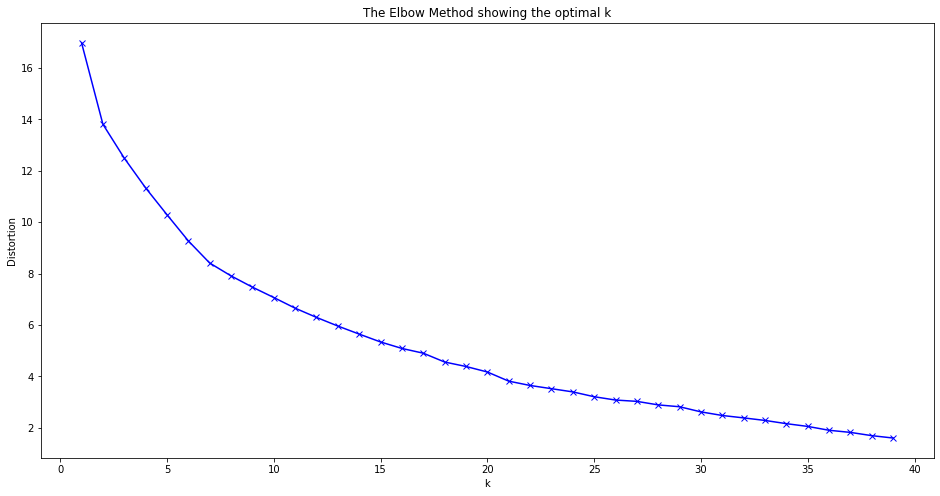

In [64]:
plt.figure(figsize=(16,8))
plt.plot(K, distortions, 'bx-')
plt.xlabel('k')
plt.ylabel('Distortion')
plt.title('The Elbow Method showing the optimal k')
plt.show()

In [65]:
kclusters = 12

kmeans = KMeans(n_clusters=kclusters, random_state=0)
kmeans.fit(restaurants_grouped_clustering)

# check cluster labels generated for each row in the dataframe
kmeans.labels_[0:40] 

array([ 3,  3,  2,  7,  0, 11, 11,  2,  3,  7,  2,  3,  9,  9,  4,  0,  2,
        4, 11, 11,  3, 11, 11,  4,  4,  4,  3,  2, 11,  0,  1,  3,  1, 11,
       11,  2,  2, 11, 11, 11], dtype=int32)

To plot the clusters we add the cluster labels for each neighborhood to the chicago dataset.

In [66]:
# add clustering labels
restaurants_sorted.insert(0, 'Cluster Labels', kmeans.labels_)

chicago_restaurants_clustered = chicago_data

# merge toronto_grouped with toronto_data to add latitude/longitude for each neighborhood
chicago_restaurants_clustered = chicago_restaurants_clustered.merge(
    restaurants_sorted.set_index('Neighborhood'), 
    how='left',
    right_on='Neighborhood',
    left_on='community')

chicago_restaurants_clustered.head()

,community,area,shape_area,perimeter,area_num_1,area_numbe,comarea_id,comarea,shape_len,geometry,...,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,DOUGLAS,0,46004621.1581,0,35,35,0,0,31027.0545098,"MULTIPOLYGON (((-87.60914 41.84469, -87.60915 ...",...,Restaurant,Fast Food Restaurant,Wings Joint,Pizza Place,Southern / Soul Food Restaurant,Fried Chicken Joint,Sandwich Place,Seafood Restaurant,Asian Restaurant,Food
1,OAKLAND,0,16913961.0408,0,36,36,0,0,19565.5061533,"MULTIPOLYGON (((-87.59215 41.81693, -87.59231 ...",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,FULLER PARK,0,19916704.8692,0,37,37,0,0,25339.0897503,"MULTIPOLYGON (((-87.62880 41.80189, -87.62879 ...",...,Fast Food Restaurant,Restaurant,Food,BBQ Joint,Ethiopian Restaurant,Cuban Restaurant,Deli / Bodega,Dim Sum Restaurant,Diner,Donut Shop
3,GRAND BOULEVARD,0,48492503.1554,0,38,38,0,0,28196.8371573,"MULTIPOLYGON (((-87.60671 41.81681, -87.60670 ...",...,Pizza Place,American Restaurant,Food,Sandwich Place,Caribbean Restaurant,BBQ Joint,Breakfast Spot,Burger Joint,Deli / Bodega,Dim Sum Restaurant
4,KENWOOD,0,29071741.9283,0,39,39,0,0,23325.1679062,"MULTIPOLYGON (((-87.59215 41.81693, -87.59215 ...",...,Pizza Place,Donut Shop,African Restaurant,Chinese Restaurant,Asian Restaurant,Food,Restaurant,Fast Food Restaurant,Seafood Restaurant,Breakfast Spot


We fix the type to plot the clusters.

In [67]:
chicago_restaurants_clustered.dropna(subset=['Cluster Labels'], how='any', inplace=True)
chicago_restaurants_clustered['Cluster Labels'] = chicago_restaurants_clustered['Cluster Labels'].astype('int64')
chicago_restaurants_clustered['Cluster Labels'].unique()

array([ 4, 11,  2,  3,  0,  5,  1,  7, 10,  9,  6,  8])

<br>

### Cluster map of restaurants

In [68]:
# create map
restaurants_clusters_map = folium.Map(location=[latitude, longitude], zoom_start=10)

# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

folium.GeoJson(community_area_geodata).add_to(restaurants_clusters_map)

# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(chicago_restaurants_clustered['Latitude'], chicago_restaurants_clustered['Longitude'], chicago_restaurants_clustered['community'], chicago_restaurants_clustered['Cluster Labels']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(restaurants_clusters_map)
       
restaurants_clusters_map

The long red cluster in the north east of the city correlates with the high number of restaurants in this area. Feel free to play around with this map.

<br>

## 7. Further analysis

Maps are a great tool to get a first feel for the data and to build an intuition about where to look next to gain more insights. But to get concrete results we have to look at the actual numbers. Also plotting these can further widen our understanding of the data.

<br>

### Crime numbers

In [69]:
counted_crimes.head()

,ID,crime_colors
community,,
ALBANY PARK,2869,#260000
ARCHER HEIGHTS,1048,#D0000
ARMOUR SQUARE,1318,#110000
ASHBURN,2988,#270000
AUBURN GRESHAM,9669,#810000


To see which neighborhoods are affected by crimes the most we plot a bar chart with descending values for crimes. Those numbers can be a huge factor for deciding where to open a restaurant to minimize the risk of robberies and to get in an overall safe neighborhood.

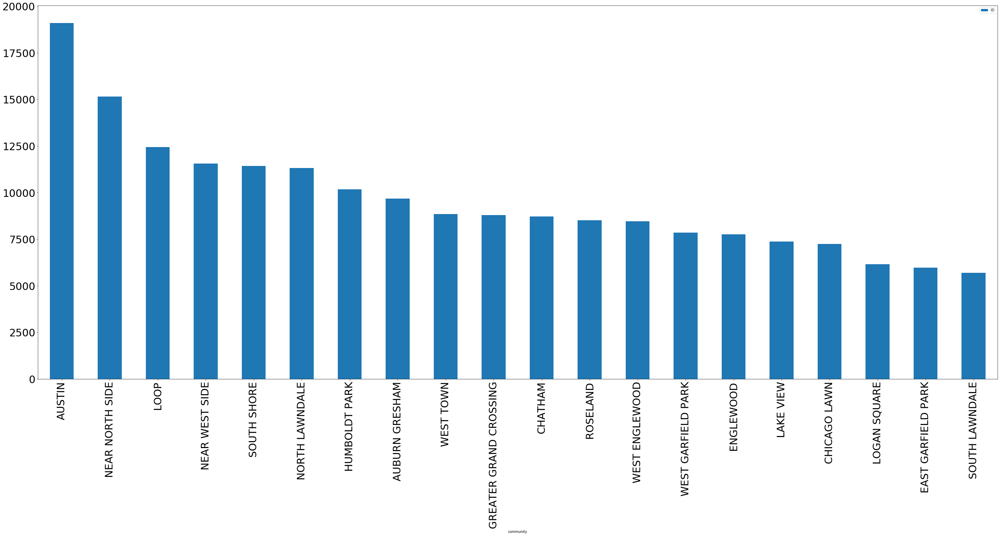

In [70]:
counted_crimes[['ID']].sort_values(by='ID', ascending=False).head(20) \
    .plot(kind='bar', figsize=(50, 20), fontsize=30)

<br>

### All restaurant and chinese restaurants numbers

In [71]:
counted_restaurants.head(20)

,Venue,restaurant_colors
Neighborhood,,
ALBANY PARK,26,#Dd0000
ARCHER HEIGHTS,15,#7f0000
ARMOUR SQUARE,16,#880000
ASHBURN,4,#220000
AUBURN GRESHAM,4,#220000
AUSTIN,4,#220000
AVALON PARK,11,#5d0000
AVONDALE,21,#B20000
BELMONT CRAGIN,13,#6e0000


We do the same for the restaurant data and also the data for the chinese restaurants.

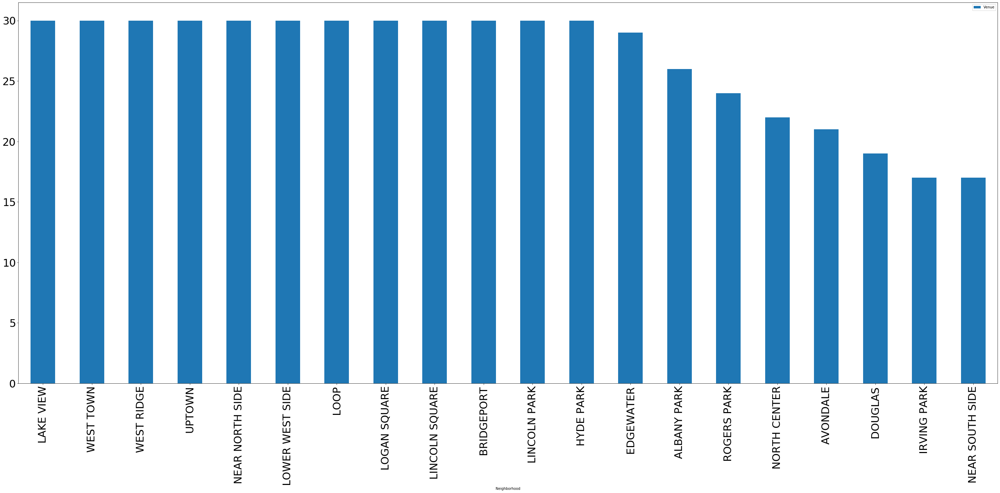

In [72]:
counted_restaurants[['Venue']].sort_values(by='Venue', ascending=False).head(20) \
    .plot(kind='bar', figsize=(50, 20), fontsize=30)

In [73]:
counted_chinese_restaurants.head(20)

,Venue,chinese_restaurant_colors
Neighborhood,,
ALBANY PARK,2,#3f0000
ARMOUR SQUARE,5,#9f0000
AVONDALE,2,#3f0000
BELMONT CRAGIN,1,#1f0000
BRIDGEPORT,8,#Ff0000
CLEARING,1,#1f0000
DOUGLAS,1,#1f0000
EAST SIDE,1,#1f0000
EDGEWATER,1,#1f0000


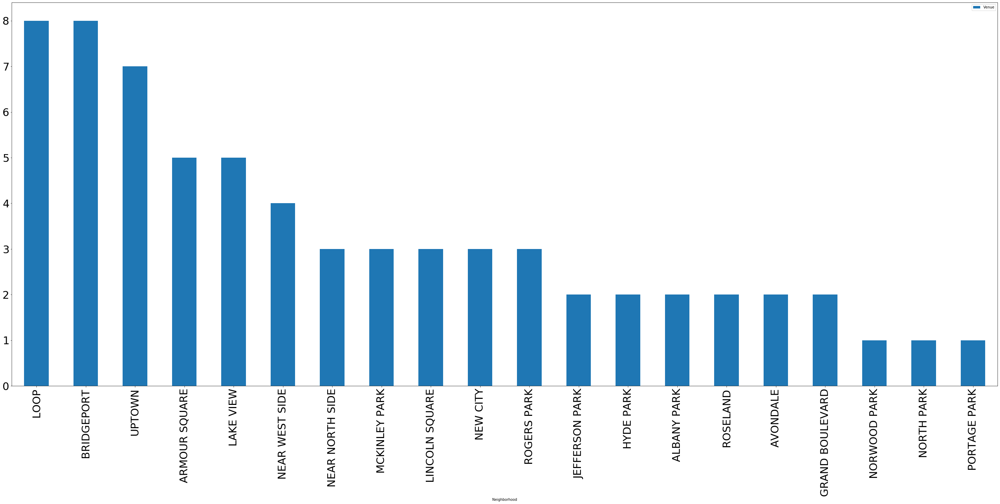

In [74]:
counted_chinese_restaurants[['Venue']].sort_values(by='Venue', ascending=False).head(20) \
    .plot(kind='bar', figsize=(50, 20), fontsize=30)

<br>

### Restaurants vs chinese restaurants

It would be interesting to plot the number of all restaurants next to the number of chinese restaurants to identify neighborhoods with 'gaps in the market'.

In [75]:
combined_restaurants = counted_restaurants.reset_index().merge(counted_chinese_restaurants.reset_index(),
                                                               left_on='Neighborhood',
                                                               right_on='Neighborhood',
                                                               how='left')
combined_restaurants.set_index('Neighborhood', inplace=True)
combined_restaurants.sort_values(by='Venue_x', ascending=False, inplace=True)
combined_restaurants.head()

,Venue_x,restaurant_colors,Venue_y,chinese_restaurant_colors
Neighborhood,,,,
LAKE VIEW,30,#Ff0000,5.0,#9f0000
WEST TOWN,30,#Ff0000,1.0,#1f0000
WEST RIDGE,30,#Ff0000,1.0,#1f0000
UPTOWN,30,#Ff0000,7.0,#Df0000
NEAR NORTH SIDE,30,#Ff0000,3.0,#5f0000


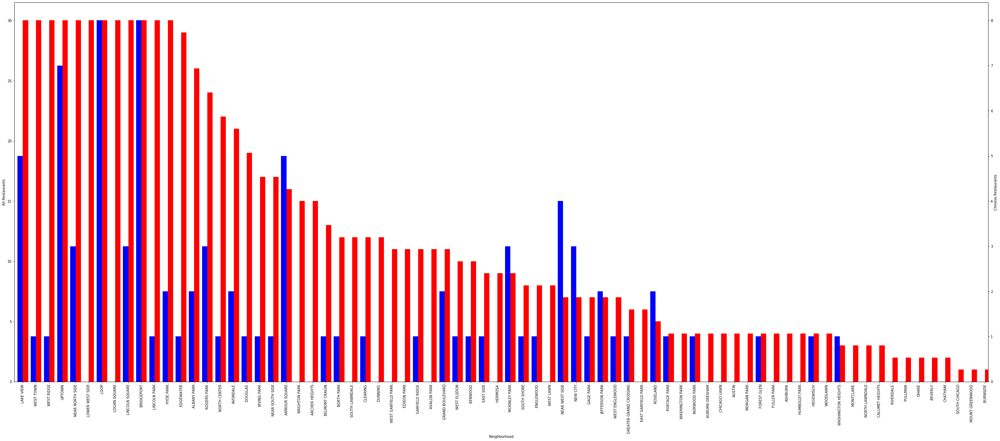

In [76]:
fig = plt.figure(figsize=(50,20)) 

ax = fig.add_subplot(111)
ax2 = ax.twinx()

width = 0.4

combined_restaurants.Venue_x.plot(kind='bar', color='red', ax=ax, width=width, position=0)
combined_restaurants.Venue_y.plot(kind='bar', color='blue', ax=ax2, width=width, position=1)

ax.set_ylabel('All Restaurants')
ax2.set_ylabel('Chinese Restaurants')

plt.show()

Not all neighborhoods have a chinese restaurant. To make sure that this is not due to a mistake by Foursquare we get rid of the NaNs and plot it again.

In [77]:
combined_restaurants.dropna(subset=['Venue_y'], inplace=True)
combined_restaurants.head()

,Venue_x,restaurant_colors,Venue_y,chinese_restaurant_colors
Neighborhood,,,,
LAKE VIEW,30,#Ff0000,5.0,#9f0000
WEST TOWN,30,#Ff0000,1.0,#1f0000
WEST RIDGE,30,#Ff0000,1.0,#1f0000
UPTOWN,30,#Ff0000,7.0,#Df0000
NEAR NORTH SIDE,30,#Ff0000,3.0,#5f0000


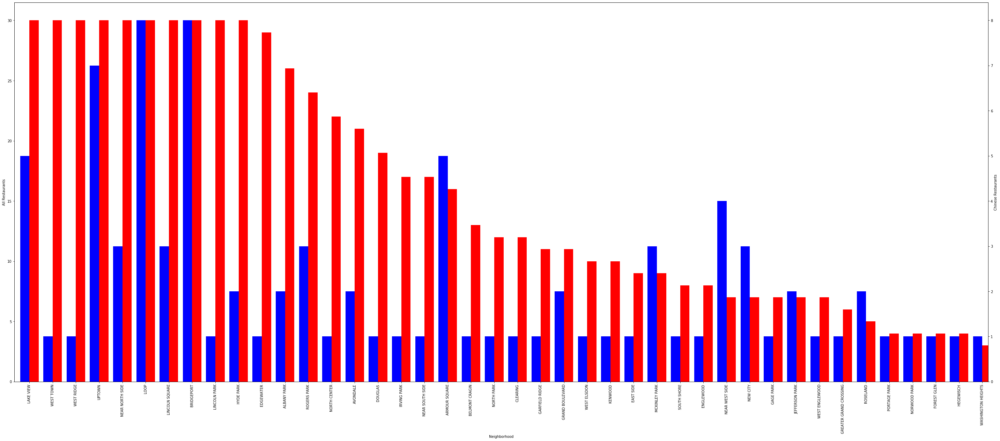

In [78]:
fig = plt.figure(figsize=(50,20)) 

ax = fig.add_subplot(111)
ax2 = ax.twinx()

width = 0.4

combined_restaurants.Venue_x.plot(kind='bar', color='red', ax=ax, width=width, position=0)
combined_restaurants.Venue_y.plot(kind='bar', color='blue', ax=ax2, width=width, position=1)

ax.set_ylabel('All Restaurants')
ax2.set_ylabel('Chinese Restaurants')

plt.show()

<br>

### Restaurant numbers vs crimes

We don't want to open a new restaurant in an unsafe area, so we plot the number of crimes next to the number of restaurants and chinese restaurants for each neighborhood.

In [79]:
combined_restaurants_with_crimes = combined_restaurants.reset_index().merge(counted_crimes.reset_index(),
                                                                           how='inner',
                                                                           left_on='Neighborhood',
                                                                           right_on='community')
combined_restaurants_with_crimes.sort_values(by='Venue_x', ascending=False, inplace=True)
combined_restaurants_with_crimes.set_index('Neighborhood', inplace=True)
combined_restaurants_with_crimes.head()

,Venue_x,restaurant_colors,Venue_y,chinese_restaurant_colors,community,ID,crime_colors
Neighborhood,,,,,,,
LAKE VIEW,30,#Ff0000,5.0,#9f0000,LAKE VIEW,7369,#620000
WEST TOWN,30,#Ff0000,1.0,#1f0000,WEST TOWN,8848,#760000
WEST RIDGE,30,#Ff0000,1.0,#1f0000,WEST RIDGE,4439,#3b0000
UPTOWN,30,#Ff0000,7.0,#Df0000,UPTOWN,4263,#380000
NEAR NORTH SIDE,30,#Ff0000,3.0,#5f0000,NEAR NORTH SIDE,15150,#Ca0000


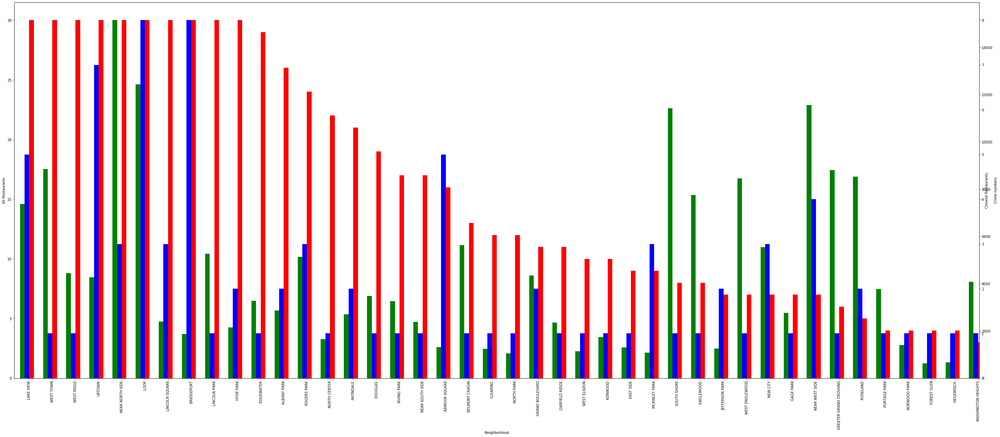

In [80]:
fig = plt.figure(figsize=(50,20)) 

ax = fig.add_subplot(111)
ax2 = ax.twinx()
ax3 = ax.twinx()

width = 0.2

combined_restaurants_with_crimes.Venue_x.plot(kind='bar', color='red', ax=ax, width=width, position=0)
combined_restaurants_with_crimes.Venue_y.plot(kind='bar', color='blue', ax=ax2, width=width, position=1)
combined_restaurants_with_crimes.ID.plot(kind='bar', color='green', ax=ax3, width=width, position=2)

ax.set_ylabel('All Restaurants')
ax2.set_ylabel('Chinese Restaurants')
ax3.set_ylabel('Crime numbers')

plt.show()

Luckily, apart from Near North Side, the areas with high crime rates are mostly in neighborhoods with very few restaurants, which are not of interest for us anyway.

<br>

### Wealth data

We do the same plots for the median household income and the average rent prices.

In [81]:
rent_data['Neighborhood'] = rent_data['Neighborhood'].str.upper()
wealth_data = income_data.merge(rent_data, how='inner', left_on='Neighborhood', right_on='Neighborhood')
wealth_data.sort_values(by='Median Household Income<', ascending=False, inplace=True)
wealth_data.set_index('Neighborhood', inplace=True)
wealth_data.head()

,Rank,Median Household Income<,income_colors,Average Rent,rent_colors
Neighborhood,,,,,
FOREST GLEN,1,112032,#Ff0000,1313,#800000
LINCOLN PARK,2,99720,#E20000,1846,#B50000
NORTH CENTER,3,99384,#E20000,1504,#930000
MOUNT GREENWOOD,8,91682,#D00000,1123,#6e0000
WEST TOWN,10,81403,#B90000,2255,#Dd0000


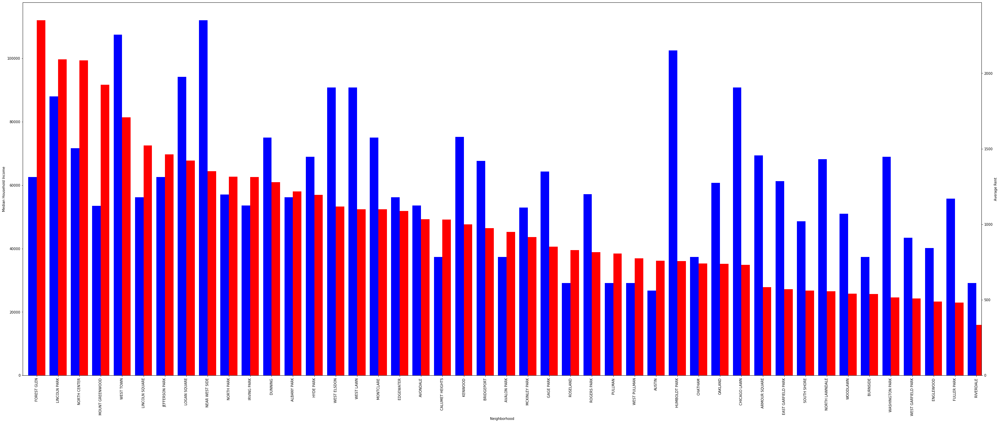

In [82]:
fig = plt.figure(figsize=(50,20)) 

ax = fig.add_subplot(111)
ax2 = ax.twinx()

width = 0.4

wealth_data['Median Household Income<'].plot(kind='bar', color='red', ax=ax, width=width, position=0)
wealth_data['Average Rent'].plot(kind='bar', color='blue', ax=ax2, width=width, position=1)

ax.set_ylabel('Median Household Income')
ax2.set_ylabel('Average Rent')

plt.show()

A regression plot reveals as expected a positive correlation between the household income and rent prices, so neighborhoods with wealthier people are also more expensive in regards to rent prices.

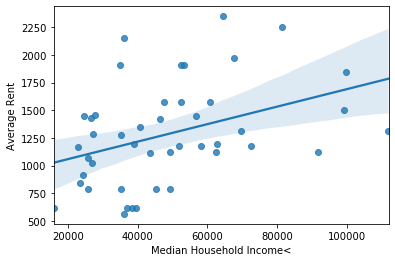

In [83]:
sns.regplot(x="Median Household Income<", y="Average Rent", data=wealth_data)

Is there a correlation with wealth and crime numbers?

In [84]:
wealth_and_crimes = wealth_data.reset_index().merge(counted_crimes, how='inner', left_on='Neighborhood', 
                                                    right_on='community')
wealth_and_crimes.set_index('Neighborhood')
wealth_and_crimes.sort_values(by='Median Household Income<', ascending=False, inplace=True)
wealth_and_crimes.head()

,Neighborhood,Rank,Median Household Income<,income_colors,Average Rent,rent_colors,ID,crime_colors
0,FOREST GLEN,1,112032,#Ff0000,1313,#800000,623,#80000
1,LINCOLN PARK,2,99720,#E20000,1846,#B50000,5265,#460000
2,NORTH CENTER,3,99384,#E20000,1504,#930000,1651,#160000
3,MOUNT GREENWOOD,8,91682,#D00000,1123,#6e0000,613,#80000
4,WEST TOWN,10,81403,#B90000,2255,#Dd0000,8848,#760000


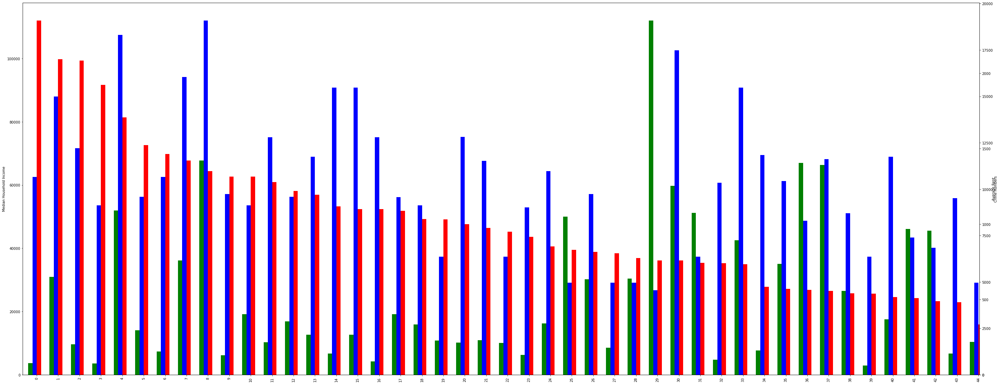

In [85]:
fig = plt.figure(figsize=(50,20)) 

ax = fig.add_subplot(111)
ax2 = ax.twinx()
ax3 = ax.twinx()

width = 0.2

wealth_and_crimes['Median Household Income<'].plot(kind='bar', color='red', ax=ax, width=width, position=0)
wealth_and_crimes['Average Rent'].plot(kind='bar', color='blue', ax=ax2, width=width, position=1)
wealth_and_crimes['ID'].plot(kind='bar', color='green', ax=ax3, width=width, position=2)

ax.set_ylabel('Median Household Income')
ax2.set_ylabel('Average Rent')
ax3.set_ylabel('Crime numbers')

plt.show()

It seems that apart from very few exceptions the crime rates go up as the income of the citizens decreases. A correlation plot with a regression line reveals that there is indeed a negative correlation between income and crime numbers.

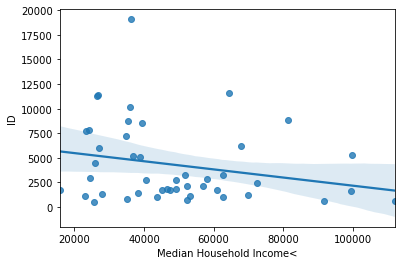

In [86]:
sns.regplot(x="Median Household Income<", y="ID", data=wealth_and_crimes)

--- 

<br>

## Thank you very much for making it through this notebook.   
Alexander Kowsik, Germany   

<br>

Please feel free to connect with me on [LinkedIn](https://www.linkedin.com/in/alexander-kowsik).